In [1]:
import os
import glob
import time
import numpy as np
from PIL import Image
from pathlib import Path
from tqdm.notebook import tqdm
import matplotlib.pyplot as plt
from skimage.color import rgb2lab, lab2rgb

import torch
from torch import nn, optim
from torchvision import transforms
from torchvision.utils import make_grid
from torch.utils.data import Dataset, DataLoader
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
use_colab = None

In [ ]:
!pip install fastai==2.4

INFO: pip is looking at multiple versions of fastai to determine which version is compatible with other requirements. This could take a while.
ERROR: Could not find a version that satisfies the requirement torch<1.10,>=1.7.0 (from fastai) (from versions: 1.11.0, 1.12.0, 1.12.1, 1.13.0, 1.13.1, 2.0.0, 2.0.1, 2.1.0, 2.1.1, 2.1.2, 2.2.0, 2.2.1, 2.2.2, 2.3.0, 2.3.1, 2.4.0, 2.4.1, 2.5.0)
ERROR: No matching distribution found for torch<1.10,>=1.7.0


In [3]:
 from fastai.data.external import untar_data, URLs
 coco_path = untar_data(URLs.COCO_SAMPLE)
 coco_path = str(coco_path) + "/train_sample"
 use_colab = True

In [4]:
if use_colab == True:
    path = coco_path
else:
    path = "Your path to the dataset"

paths = glob.glob(path + "/*.jpg") # Grabbing all the image file names
np.random.seed(123)
paths_subset = np.random.choice(paths, 20_000, replace=False) # choosing 1000 images randomly
rand_idxs = np.random.permutation(20_000)
train_idxs = rand_idxs[:18000] # choosing the first 8000 as training set
val_idxs = rand_idxs[18000:] # choosing last 2000 as validation set
train_paths = paths_subset[train_idxs]
val_paths = paths_subset[val_idxs]
print(len(train_paths), len(val_paths))

18000 2000


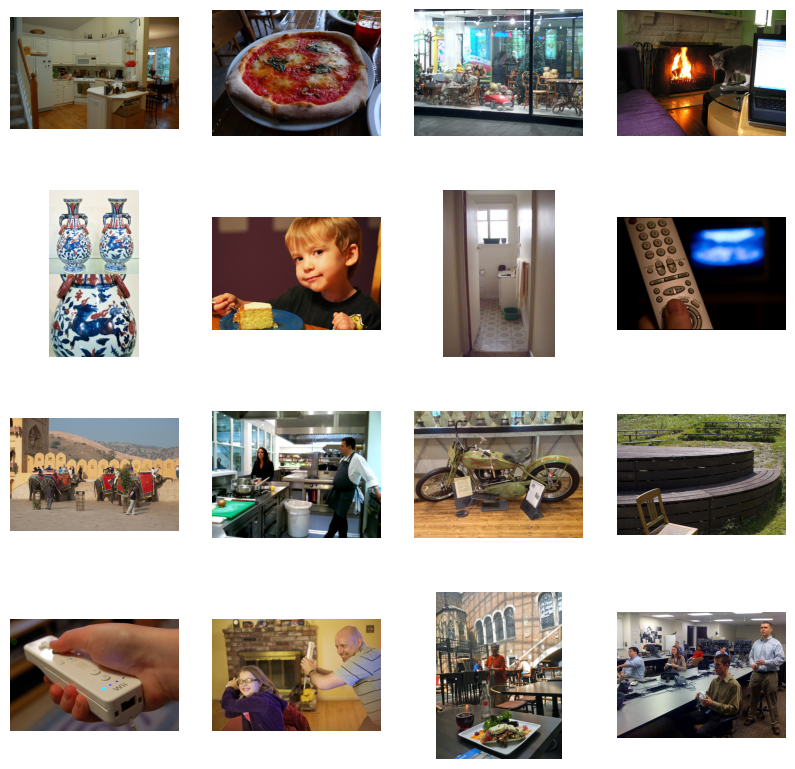

In [5]:
_, axes = plt.subplots(4, 4, figsize=(10, 10))
for ax, img_path in zip(axes.flatten(), train_paths):
    ax.imshow(Image.open(img_path))
    ax.axis("off")

In [6]:
SIZE = 256
class ColorizationDataset(Dataset):
    def __init__(self, paths, split='train'):
        if split == 'train':
            self.transforms = transforms.Compose([
                transforms.Resize((SIZE, SIZE),  Image.BICUBIC),
                transforms.RandomHorizontalFlip(), # A little data augmentation!
            ])
        elif split == 'val':
            self.transforms = transforms.Resize((SIZE, SIZE),  Image.BICUBIC)

        self.split = split
        self.size = SIZE
        self.paths = paths

    def __getitem__(self, idx):
        img = Image.open(self.paths[idx]).convert("RGB")
        img = self.transforms(img)
        img = np.array(img)
        img_lab = rgb2lab(img).astype("float32") # Converting RGB to L*a*b
        img_lab = transforms.ToTensor()(img_lab)
        L = img_lab[[0], ...] / 50. - 1. # Between -1 and 1
        ab = img_lab[[1, 2], ...] / 110. # Between -1 and 1

        return {'L': L, 'ab': ab}

    def __len__(self):
        return len(self.paths)

def make_dataloaders(batch_size=16, n_workers=4, pin_memory=True, **kwargs): # A handy function to make our dataloaders
    dataset = ColorizationDataset(**kwargs)
    dataloader = DataLoader(dataset, batch_size=batch_size, num_workers=n_workers,
                            pin_memory=pin_memory)
    return dataloader

In [7]:
train_dl = make_dataloaders(paths=train_paths, split='train')
val_dl = make_dataloaders(paths=val_paths, split='val')

data = next(iter(train_dl))
Ls, abs_ = data['L'], data['ab']
print(Ls.shape, abs_.shape)
print(len(train_dl), len(val_dl))

/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py:617: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(


torch.Size([16, 1, 256, 256]) torch.Size([16, 2, 256, 256])
1125 125


In [8]:
class UnetBlock(nn.Module):
    def __init__(self, nf, ni, submodule=None, input_c=None, dropout=False,
                 innermost=False, outermost=False):
        super().__init__()
        self.outermost = outermost
        if input_c is None: input_c = nf
        downconv = nn.Conv2d(input_c, ni, kernel_size=4,
                             stride=2, padding=1, bias=False)
        downrelu = nn.LeakyReLU(0.2, True)
        downnorm = nn.BatchNorm2d(ni)
        uprelu = nn.ReLU(True)
        upnorm = nn.BatchNorm2d(nf)

        if outermost:
            upconv = nn.ConvTranspose2d(ni * 2, nf, kernel_size=4,
                                        stride=2, padding=1)
            down = [downconv]
            up = [uprelu, upconv, nn.Tanh()]
            model = down + [submodule] + up
        elif innermost:
            upconv = nn.ConvTranspose2d(ni, nf, kernel_size=4,
                                        stride=2, padding=1, bias=False)
            down = [downrelu, downconv]
            up = [uprelu, upconv, upnorm]
            model = down + up
        else:
            upconv = nn.ConvTranspose2d(ni * 2, nf, kernel_size=4,
                                        stride=2, padding=1, bias=False)
            down = [downrelu, downconv, downnorm]
            up = [uprelu, upconv, upnorm]
            if dropout: up += [nn.Dropout(0.5)]
            model = down + [submodule] + up
        self.model = nn.Sequential(*model)

    def forward(self, x):
        if self.outermost:
            return self.model(x)
        else:
            return torch.cat([x, self.model(x)], 1)

class Unet(nn.Module):
    def __init__(self, input_c=1, output_c=2, n_down=8, num_filters=64):
        super().__init__()
        unet_block = UnetBlock(num_filters * 8, num_filters * 8, innermost=True)
        for _ in range(n_down - 5):
            unet_block = UnetBlock(num_filters * 8, num_filters * 8, submodule=unet_block, dropout=True)
        out_filters = num_filters * 8
        for _ in range(3):
            unet_block = UnetBlock(out_filters // 2, out_filters, submodule=unet_block)
            out_filters //= 2
        self.model = UnetBlock(output_c, out_filters, input_c=input_c, submodule=unet_block, outermost=True)

    def forward(self, x):
        return self.model(x)

In [9]:
class PatchDiscriminator(nn.Module):
    def __init__(self, input_c, num_filters=64, n_down=3):
        super().__init__()
        model = [self.get_layers(input_c, num_filters, norm=False)]
        model += [self.get_layers(num_filters * 2 ** i, num_filters * 2 ** (i + 1), s=1 if i == (n_down-1) else 2)
                          for i in range(n_down)] # the 'if' statement is taking care of not using
                                                  # stride of 2 for the last block in this loop
        model += [self.get_layers(num_filters * 2 ** n_down, 1, s=1, norm=False, act=False)] # Make sure to not use normalization or
                                                                                             # activation for the last layer of the model
        self.model = nn.Sequential(*model)

    def get_layers(self, ni, nf, k=4, s=2, p=1, norm=True, act=True): # when needing to make some repeatitive blocks of layers,
        layers = [nn.Conv2d(ni, nf, k, s, p, bias=not norm)]          # it's always helpful to make a separate method for that purpose
        if norm: layers += [nn.BatchNorm2d(nf)]
        if act: layers += [nn.LeakyReLU(0.2, True)]
        return nn.Sequential(*layers)

    def forward(self, x):
        return self.model(x)

In [10]:
PatchDiscriminator(3)

PatchDiscriminator(
  (model): Sequential(
    (0): Sequential(
      (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
      (1): LeakyReLU(negative_slope=0.2, inplace=True)
    )
    (1): Sequential(
      (0): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): LeakyReLU(negative_slope=0.2, inplace=True)
    )
    (2): Sequential(
      (0): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (1): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): LeakyReLU(negative_slope=0.2, inplace=True)
    )
    (3): Sequential(
      (0): Conv2d(256, 512, kernel_size=(4, 4), stride=(1, 1), padding=(1, 1), bias=False)
      (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): LeakyReLU(negative_slope=0.2, inplace=True)
    )
    (

In [11]:
discriminator = PatchDiscriminator(3)
dummy_input = torch.randn(16, 3, 256, 256) # batch_size, channels, size, size
out = discriminator(dummy_input)
out.shape

torch.Size([16, 1, 30, 30])

In [12]:
class GANLoss(nn.Module):
    def __init__(self, gan_mode='vanilla', real_label=1.0, fake_label=0.0):
        super().__init__()
        self.register_buffer('real_label', torch.tensor(real_label))
        self.register_buffer('fake_label', torch.tensor(fake_label))
        if gan_mode == 'vanilla':
            self.loss = nn.BCEWithLogitsLoss()
        elif gan_mode == 'lsgan':
            self.loss = nn.MSELoss()

    def get_labels(self, preds, target_is_real):
        if target_is_real:
            labels = self.real_label
        else:
            labels = self.fake_label
        return labels.expand_as(preds)

    def __call__(self, preds, target_is_real):
        labels = self.get_labels(preds, target_is_real)
        loss = self.loss(preds, labels)
        return loss

In [14]:
def init_weights(net, init='norm', gain=0.02):

    def init_func(m):
        classname = m.__class__.__name__
        if hasattr(m, 'weight') and 'Conv' in classname:
            if init == 'norm':
                nn.init.normal_(m.weight.data, mean=0.0, std=gain)
            elif init == 'xavier':
                nn.init.xavier_normal_(m.weight.data, gain=gain)
            elif init == 'kaiming':
                nn.init.kaiming_normal_(m.weight.data, a=0, mode='fan_in')

            if hasattr(m, 'bias') and m.bias is not None:
                nn.init.constant_(m.bias.data, 0.0)
        elif 'BatchNorm2d' in classname:
            nn.init.normal_(m.weight.data, 1., gain)
            nn.init.constant_(m.bias.data, 0.)

    net.apply(init_func)
    print(f"model initialized with {init} initialization")
    return net

def init_model(model, device):
    model = model.to(device)
    model = init_weights(model)
    return model

In [15]:
class MainModel(nn.Module):
    def __init__(self, net_G=None, lr_G=2e-4, lr_D=2e-4,
                 beta1=0.5, beta2=0.999, lambda_L1=100.):
        super().__init__()

        self.device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
        self.lambda_L1 = lambda_L1

        if net_G is None:
            self.net_G = init_model(Unet(input_c=1, output_c=2, n_down=8, num_filters=64), self.device)
        else:
            self.net_G = net_G.to(self.device)
        self.net_D = init_model(PatchDiscriminator(input_c=3, n_down=3, num_filters=64), self.device)
        self.GANcriterion = GANLoss(gan_mode='vanilla').to(self.device)
        self.L1criterion = nn.L1Loss()
        self.opt_G = optim.Adam(self.net_G.parameters(), lr=lr_G, betas=(beta1, beta2))
        self.opt_D = optim.Adam(self.net_D.parameters(), lr=lr_D, betas=(beta1, beta2))

    def set_requires_grad(self, model, requires_grad=True):
        for p in model.parameters():
            p.requires_grad = requires_grad

    def setup_input(self, data):
        self.L = data['L'].to(self.device)
        self.ab = data['ab'].to(self.device)

    def forward(self):
        self.fake_color = self.net_G(self.L)

    def backward_D(self):
        fake_image = torch.cat([self.L, self.fake_color], dim=1)
        fake_preds = self.net_D(fake_image.detach())
        self.loss_D_fake = self.GANcriterion(fake_preds, False)
        real_image = torch.cat([self.L, self.ab], dim=1)
        real_preds = self.net_D(real_image)
        self.loss_D_real = self.GANcriterion(real_preds, True)
        self.loss_D = (self.loss_D_fake + self.loss_D_real) * 0.5
        self.loss_D.backward()

    def backward_G(self):
        fake_image = torch.cat([self.L, self.fake_color], dim=1)
        fake_preds = self.net_D(fake_image)
        self.loss_G_GAN = self.GANcriterion(fake_preds, True)
        self.loss_G_L1 = self.L1criterion(self.fake_color, self.ab) * self.lambda_L1
        self.loss_G = self.loss_G_GAN + self.loss_G_L1
        self.loss_G.backward()

    def optimize(self):
        self.forward()
        self.net_D.train()
        self.set_requires_grad(self.net_D, True)
        self.opt_D.zero_grad()
        self.backward_D()
        self.opt_D.step()

        self.net_G.train()
        self.set_requires_grad(self.net_D, False)
        self.opt_G.zero_grad()
        self.backward_G()
        self.opt_G.step()

In [16]:
class AverageMeter:
    def __init__(self):
        self.reset()

    def reset(self):
        self.count, self.avg, self.sum = [0.] * 3

    def update(self, val, count=1):
        self.count += count
        self.sum += count * val
        self.avg = self.sum / self.count

def create_loss_meters():
    loss_D_fake = AverageMeter()
    loss_D_real = AverageMeter()
    loss_D = AverageMeter()
    loss_G_GAN = AverageMeter()
    loss_G_L1 = AverageMeter()
    loss_G = AverageMeter()

    return {'loss_D_fake': loss_D_fake,
            'loss_D_real': loss_D_real,
            'loss_D': loss_D,
            'loss_G_GAN': loss_G_GAN,
            'loss_G_L1': loss_G_L1,
            'loss_G': loss_G}

def update_losses(model, loss_meter_dict, count):
    for loss_name, loss_meter in loss_meter_dict.items():
        loss = getattr(model, loss_name)
        loss_meter.update(loss.item(), count=count)

def lab_to_rgb(L, ab):
    """
    Takes a batch of images
    """

    L = (L + 1.) * 50.
    ab = ab * 110.
    Lab = torch.cat([L, ab], dim=1).permute(0, 2, 3, 1).cpu().numpy()
    rgb_imgs = []
    for img in Lab:
        img_rgb = lab2rgb(img)
        rgb_imgs.append(img_rgb)
    return np.stack(rgb_imgs, axis=0)

def visualize(model, data, save=True):
    model.net_G.eval()
    with torch.no_grad():
        model.setup_input(data)
        model.forward()
    model.net_G.train()
    fake_color = model.fake_color.detach()
    real_color = model.ab
    L = model.L
    fake_imgs = lab_to_rgb(L, fake_color)
    real_imgs = lab_to_rgb(L, real_color)
    fig = plt.figure(figsize=(15, 8))
    for i in range(5):
        ax = plt.subplot(3, 5, i + 1)
        ax.imshow(L[i][0].cpu(), cmap='gray')
        ax.axis("off")
        ax = plt.subplot(3, 5, i + 1 + 5)
        ax.imshow(fake_imgs[i])
        ax.axis("off")
        ax = plt.subplot(3, 5, i + 1 + 10)
        ax.imshow(real_imgs[i])
        ax.axis("off")
    plt.show()
    if save:
        fig.savefig(f"colorization_{time.time()}.png")

def log_results(loss_meter_dict):
    for loss_name, loss_meter in loss_meter_dict.items():
        print(f"{loss_name}: {loss_meter.avg:.5f}")

model initialized with norm initialization
model initialized with norm initialization


  0%|          | 0/1125 [00:00<?, ?it/s]


Epoch 1/10
Iteration 200/1125
loss_D_fake: 0.49507
loss_D_real: 0.50768
loss_D: 0.50138
loss_G_GAN: 1.43683
loss_G_L1: 9.27945
loss_G: 10.71628


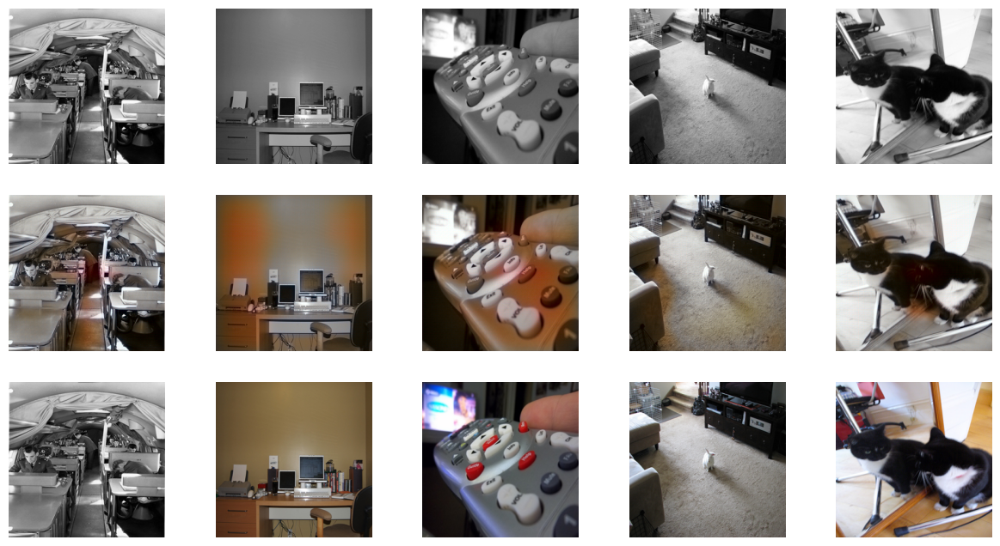


Epoch 1/10
Iteration 400/1125
loss_D_fake: 0.47944
loss_D_real: 0.48531
loss_D: 0.48238
loss_G_GAN: 1.54117
loss_G_L1: 9.73803
loss_G: 11.27920


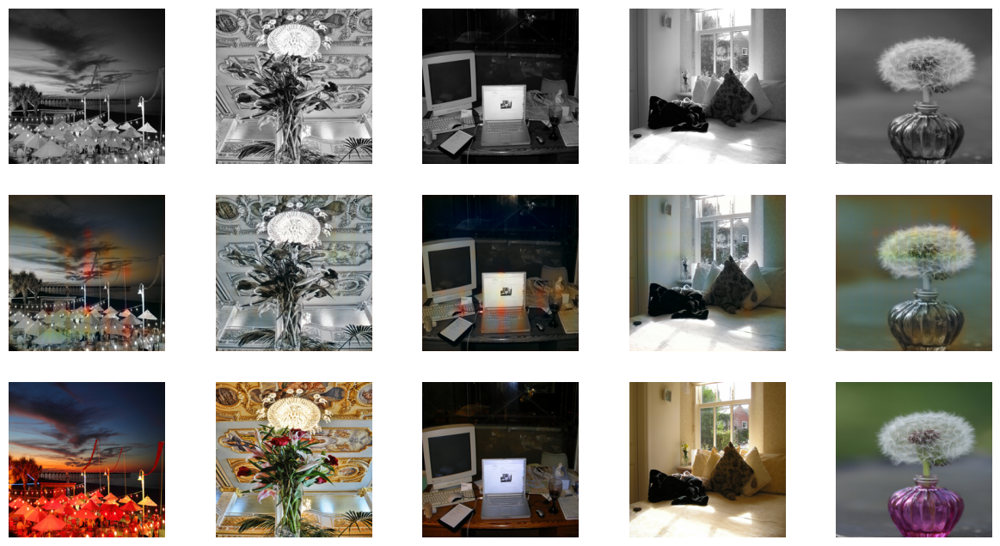


Epoch 1/10
Iteration 600/1125
loss_D_fake: 0.48163
loss_D_real: 0.49366
loss_D: 0.48765
loss_G_GAN: 1.52680
loss_G_L1: 10.06657
loss_G: 11.59338


<ipython-input-16-a66e46705176>:43: UserWarning: Conversion from CIE-LAB, via XYZ to sRGB color space resulted in 2 negative Z values that have been clipped to zero
  img_rgb = lab2rgb(img)
<ipython-input-16-a66e46705176>:43: UserWarning: Conversion from CIE-LAB, via XYZ to sRGB color space resulted in 5 negative Z values that have been clipped to zero
  img_rgb = lab2rgb(img)
<ipython-input-16-a66e46705176>:43: UserWarning: Conversion from CIE-LAB, via XYZ to sRGB color space resulted in 6 negative Z values that have been clipped to zero
  img_rgb = lab2rgb(img)


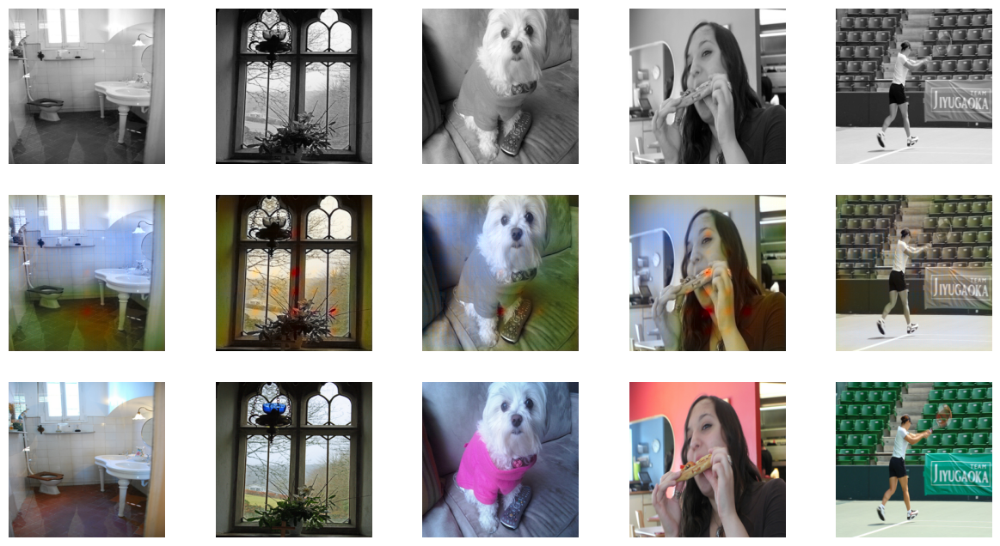


Epoch 1/10
Iteration 800/1125
loss_D_fake: 0.49176
loss_D_real: 0.50609
loss_D: 0.49892
loss_G_GAN: 1.49302
loss_G_L1: 10.24455
loss_G: 11.73758


<ipython-input-16-a66e46705176>:43: UserWarning: Conversion from CIE-LAB, via XYZ to sRGB color space resulted in 21 negative Z values that have been clipped to zero
  img_rgb = lab2rgb(img)
<ipython-input-16-a66e46705176>:43: UserWarning: Conversion from CIE-LAB, via XYZ to sRGB color space resulted in 17 negative Z values that have been clipped to zero
  img_rgb = lab2rgb(img)
<ipython-input-16-a66e46705176>:43: UserWarning: Conversion from CIE-LAB, via XYZ to sRGB color space resulted in 1 negative Z values that have been clipped to zero
  img_rgb = lab2rgb(img)
<ipython-input-16-a66e46705176>:43: UserWarning: Conversion from CIE-LAB, via XYZ to sRGB color space resulted in 91 negative Z values that have been clipped to zero
  img_rgb = lab2rgb(img)
<ipython-input-16-a66e46705176>:43: UserWarning: Conversion from CIE-LAB, via XYZ to sRGB color space resulted in 3 negative Z values that have been clipped to zero
  img_rgb = lab2rgb(img)
<ipython-input-16-a66e46705176>:43: UserWarning

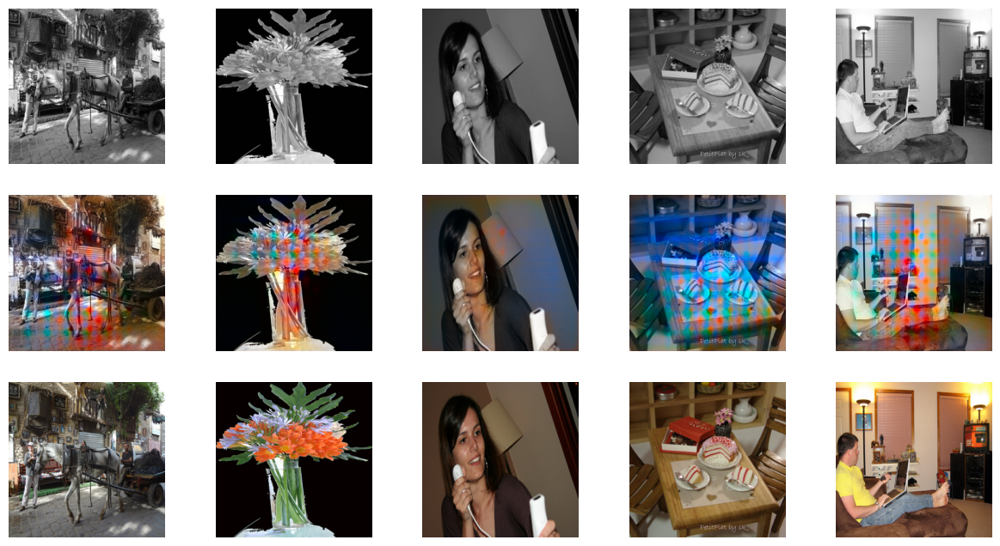


Epoch 1/10
Iteration 1000/1125
loss_D_fake: 0.49628
loss_D_real: 0.51527
loss_D: 0.50577
loss_G_GAN: 1.46475
loss_G_L1: 10.36856
loss_G: 11.83331


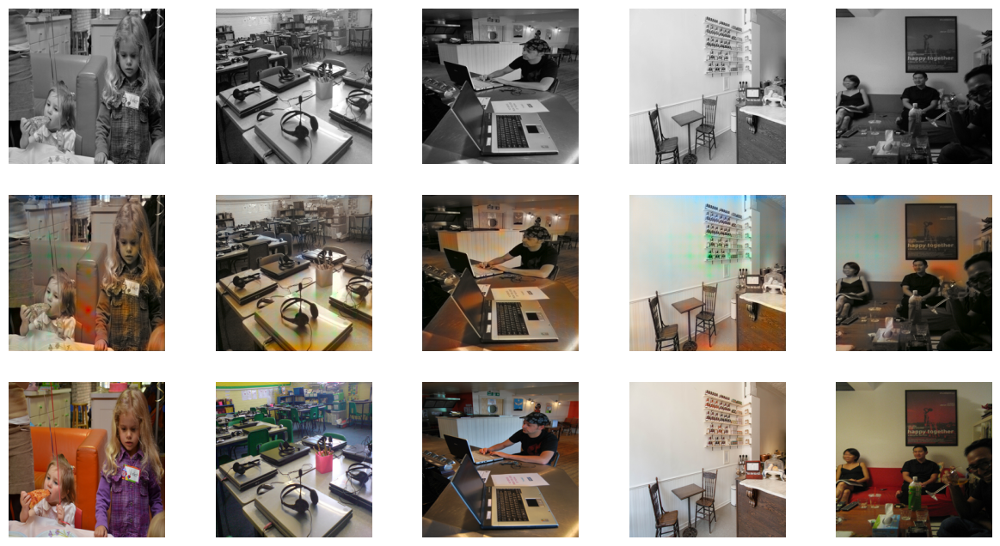

  0%|          | 0/1125 [00:00<?, ?it/s]


Epoch 2/10
Iteration 200/1125
loss_D_fake: 0.50881
loss_D_real: 0.55314
loss_D: 0.53098
loss_G_GAN: 1.33024
loss_G_L1: 10.91245
loss_G: 12.24270


<ipython-input-16-a66e46705176>:43: UserWarning: Conversion from CIE-LAB, via XYZ to sRGB color space resulted in 19 negative Z values that have been clipped to zero
  img_rgb = lab2rgb(img)
<ipython-input-16-a66e46705176>:43: UserWarning: Conversion from CIE-LAB, via XYZ to sRGB color space resulted in 27 negative Z values that have been clipped to zero
  img_rgb = lab2rgb(img)


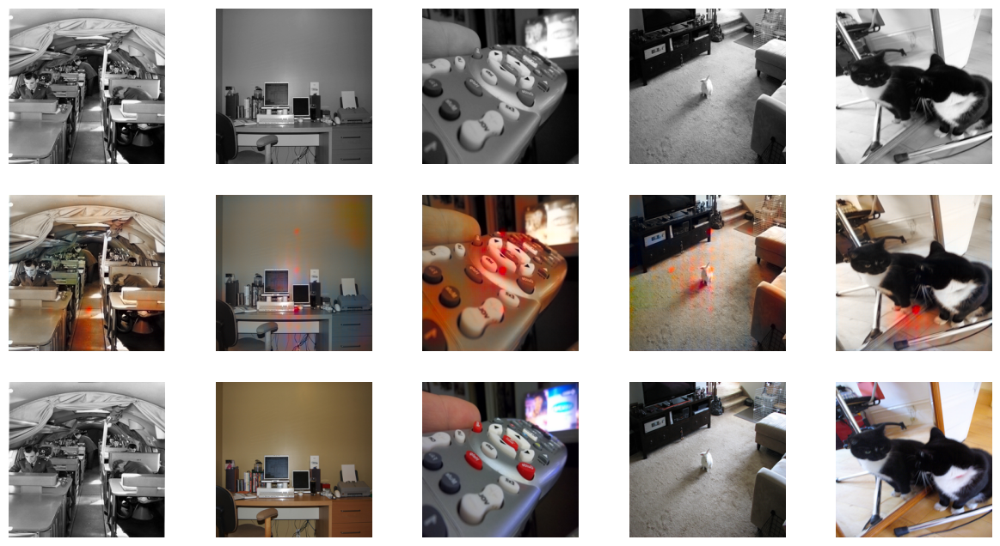


Epoch 2/10
Iteration 400/1125
loss_D_fake: 0.50523
loss_D_real: 0.55789
loss_D: 0.53156
loss_G_GAN: 1.34238
loss_G_L1: 10.98274
loss_G: 12.32512


<ipython-input-16-a66e46705176>:43: UserWarning: Conversion from CIE-LAB, via XYZ to sRGB color space resulted in 33 negative Z values that have been clipped to zero
  img_rgb = lab2rgb(img)
<ipython-input-16-a66e46705176>:43: UserWarning: Conversion from CIE-LAB, via XYZ to sRGB color space resulted in 100 negative Z values that have been clipped to zero
  img_rgb = lab2rgb(img)
<ipython-input-16-a66e46705176>:43: UserWarning: Conversion from CIE-LAB, via XYZ to sRGB color space resulted in 9 negative Z values that have been clipped to zero
  img_rgb = lab2rgb(img)
<ipython-input-16-a66e46705176>:43: UserWarning: Conversion from CIE-LAB, via XYZ to sRGB color space resulted in 179 negative Z values that have been clipped to zero
  img_rgb = lab2rgb(img)


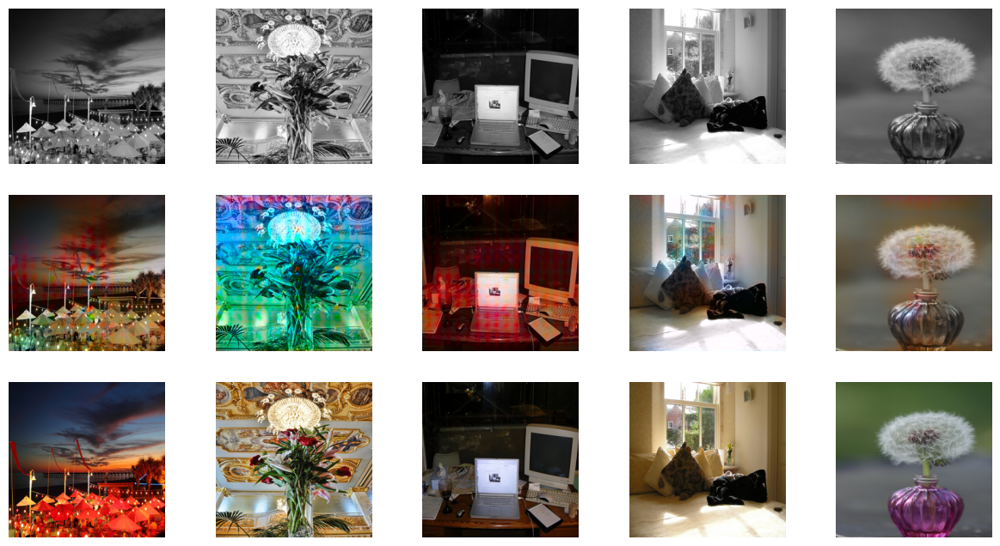


Epoch 2/10
Iteration 600/1125
loss_D_fake: 0.50344
loss_D_real: 0.55623
loss_D: 0.52984
loss_G_GAN: 1.33603
loss_G_L1: 11.03068
loss_G: 12.36672


<ipython-input-16-a66e46705176>:43: UserWarning: Conversion from CIE-LAB, via XYZ to sRGB color space resulted in 63 negative Z values that have been clipped to zero
  img_rgb = lab2rgb(img)
<ipython-input-16-a66e46705176>:43: UserWarning: Conversion from CIE-LAB, via XYZ to sRGB color space resulted in 99 negative Z values that have been clipped to zero
  img_rgb = lab2rgb(img)
<ipython-input-16-a66e46705176>:43: UserWarning: Conversion from CIE-LAB, via XYZ to sRGB color space resulted in 52 negative Z values that have been clipped to zero
  img_rgb = lab2rgb(img)
<ipython-input-16-a66e46705176>:43: UserWarning: Conversion from CIE-LAB, via XYZ to sRGB color space resulted in 358 negative Z values that have been clipped to zero
  img_rgb = lab2rgb(img)
<ipython-input-16-a66e46705176>:43: UserWarning: Conversion from CIE-LAB, via XYZ to sRGB color space resulted in 192 negative Z values that have been clipped to zero
  img_rgb = lab2rgb(img)
<ipython-input-16-a66e46705176>:43: UserWar

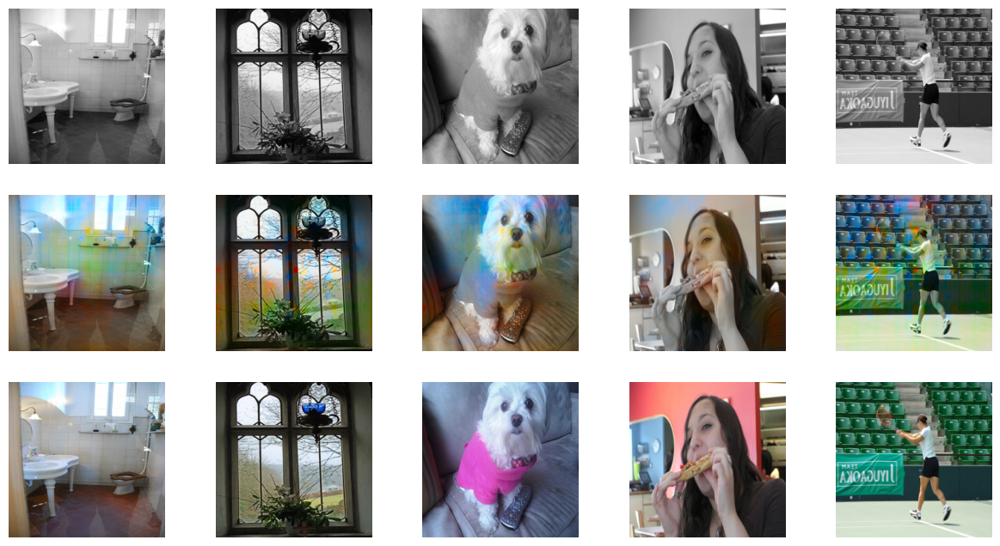


Epoch 2/10
Iteration 800/1125
loss_D_fake: 0.51267
loss_D_real: 0.56165
loss_D: 0.53716
loss_G_GAN: 1.31672
loss_G_L1: 11.02606
loss_G: 12.34278


<ipython-input-16-a66e46705176>:43: UserWarning: Conversion from CIE-LAB, via XYZ to sRGB color space resulted in 285 negative Z values that have been clipped to zero
  img_rgb = lab2rgb(img)
<ipython-input-16-a66e46705176>:43: UserWarning: Conversion from CIE-LAB, via XYZ to sRGB color space resulted in 16 negative Z values that have been clipped to zero
  img_rgb = lab2rgb(img)
<ipython-input-16-a66e46705176>:43: UserWarning: Conversion from CIE-LAB, via XYZ to sRGB color space resulted in 18 negative Z values that have been clipped to zero
  img_rgb = lab2rgb(img)
<ipython-input-16-a66e46705176>:43: UserWarning: Conversion from CIE-LAB, via XYZ to sRGB color space resulted in 115 negative Z values that have been clipped to zero
  img_rgb = lab2rgb(img)
<ipython-input-16-a66e46705176>:43: UserWarning: Conversion from CIE-LAB, via XYZ to sRGB color space resulted in 302 negative Z values that have been clipped to zero
  img_rgb = lab2rgb(img)
<ipython-input-16-a66e46705176>:43: UserWa

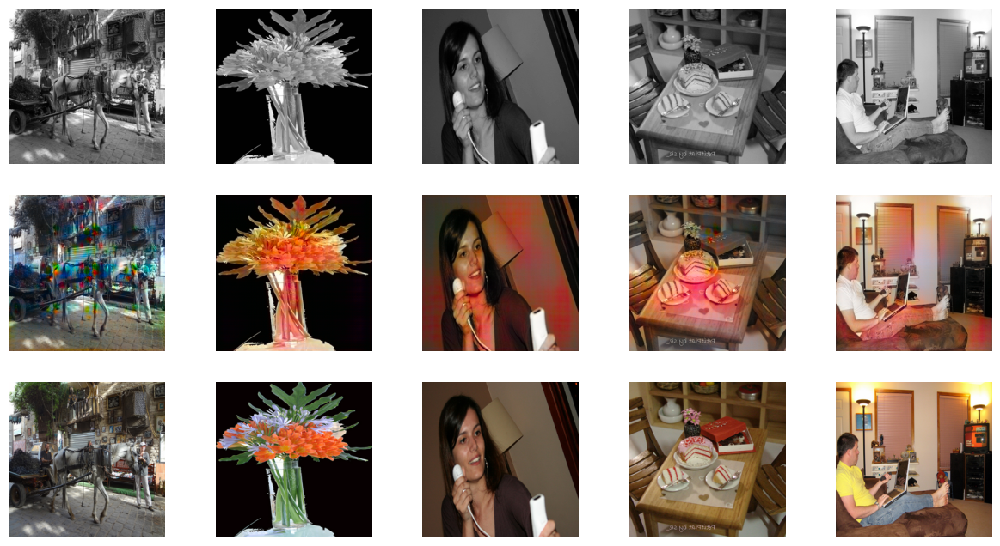


Epoch 2/10
Iteration 1000/1125
loss_D_fake: 0.51760
loss_D_real: 0.56654
loss_D: 0.54207
loss_G_GAN: 1.29883
loss_G_L1: 11.01161
loss_G: 12.31045


<ipython-input-16-a66e46705176>:43: UserWarning: Conversion from CIE-LAB, via XYZ to sRGB color space resulted in 4 negative Z values that have been clipped to zero
  img_rgb = lab2rgb(img)
<ipython-input-16-a66e46705176>:43: UserWarning: Conversion from CIE-LAB, via XYZ to sRGB color space resulted in 22 negative Z values that have been clipped to zero
  img_rgb = lab2rgb(img)


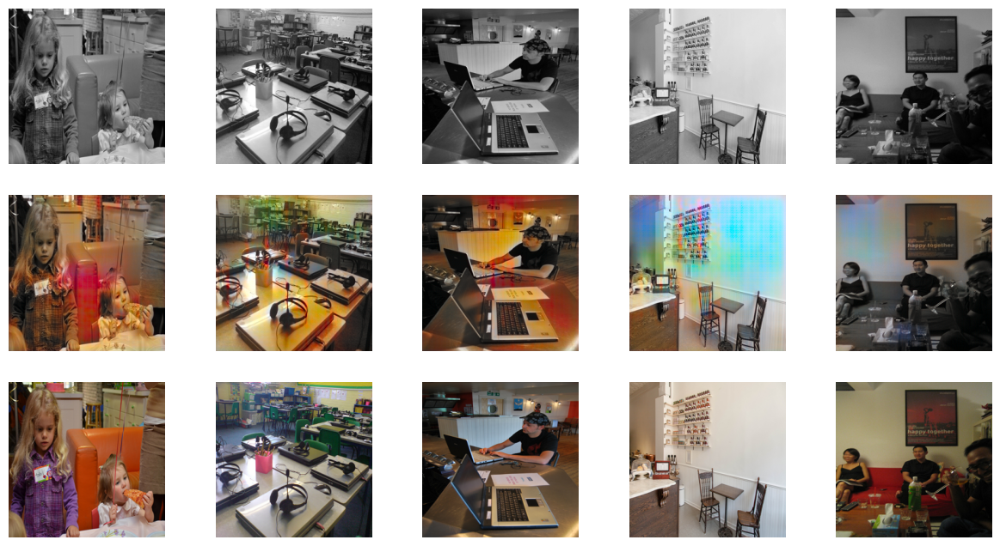

  0%|          | 0/1125 [00:00<?, ?it/s]


Epoch 3/10
Iteration 200/1125
loss_D_fake: 0.53269
loss_D_real: 0.58954
loss_D: 0.56111
loss_G_GAN: 1.23053
loss_G_L1: 11.00560
loss_G: 12.23613


<ipython-input-16-a66e46705176>:43: UserWarning: Conversion from CIE-LAB, via XYZ to sRGB color space resulted in 49 negative Z values that have been clipped to zero
  img_rgb = lab2rgb(img)


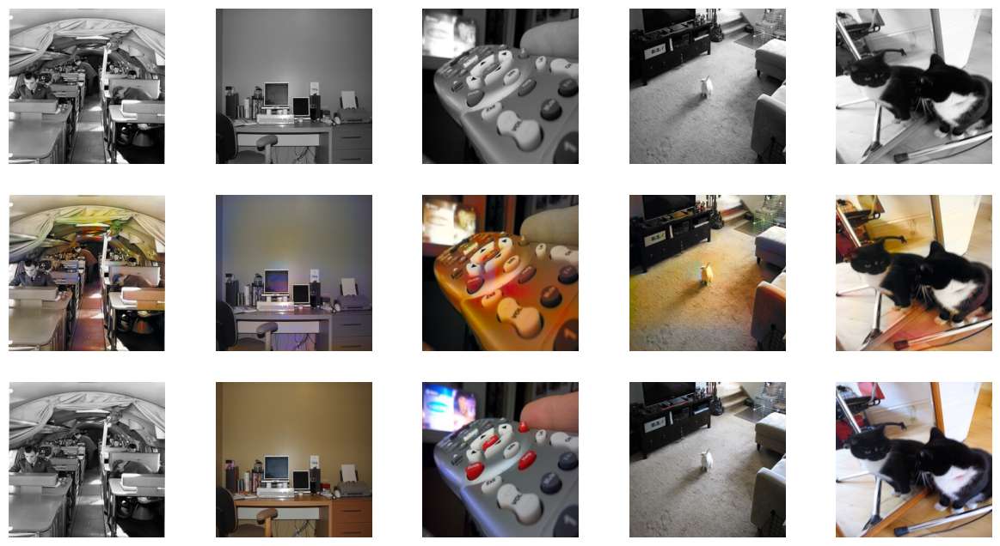


Epoch 3/10
Iteration 400/1125
loss_D_fake: 0.52142
loss_D_real: 0.58331
loss_D: 0.55237
loss_G_GAN: 1.25166
loss_G_L1: 10.98830
loss_G: 12.23996


<ipython-input-16-a66e46705176>:43: UserWarning: Conversion from CIE-LAB, via XYZ to sRGB color space resulted in 11 negative Z values that have been clipped to zero
  img_rgb = lab2rgb(img)
<ipython-input-16-a66e46705176>:43: UserWarning: Conversion from CIE-LAB, via XYZ to sRGB color space resulted in 26 negative Z values that have been clipped to zero
  img_rgb = lab2rgb(img)
<ipython-input-16-a66e46705176>:43: UserWarning: Conversion from CIE-LAB, via XYZ to sRGB color space resulted in 28 negative Z values that have been clipped to zero
  img_rgb = lab2rgb(img)


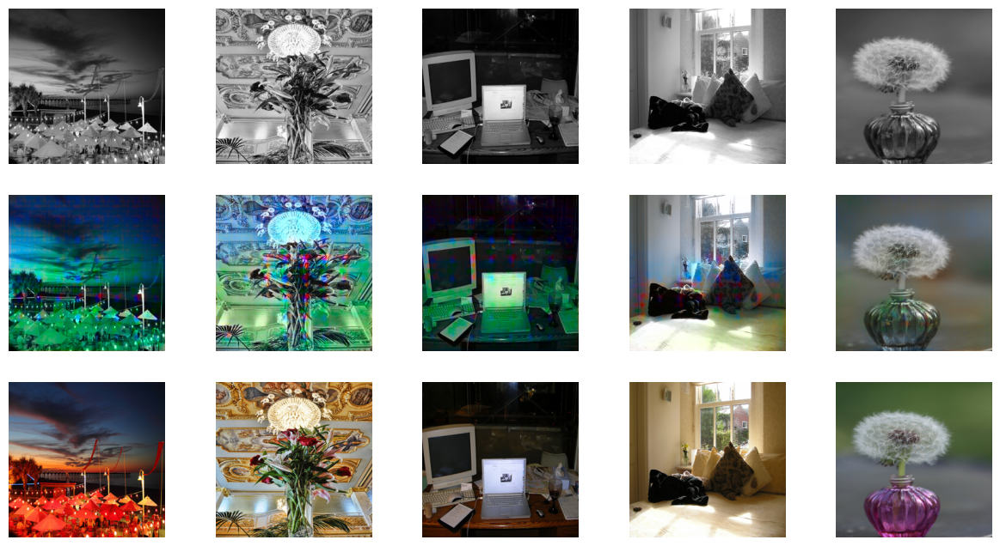


Epoch 3/10
Iteration 600/1125
loss_D_fake: 0.51931
loss_D_real: 0.58100
loss_D: 0.55016
loss_G_GAN: 1.25322
loss_G_L1: 11.02063
loss_G: 12.27386


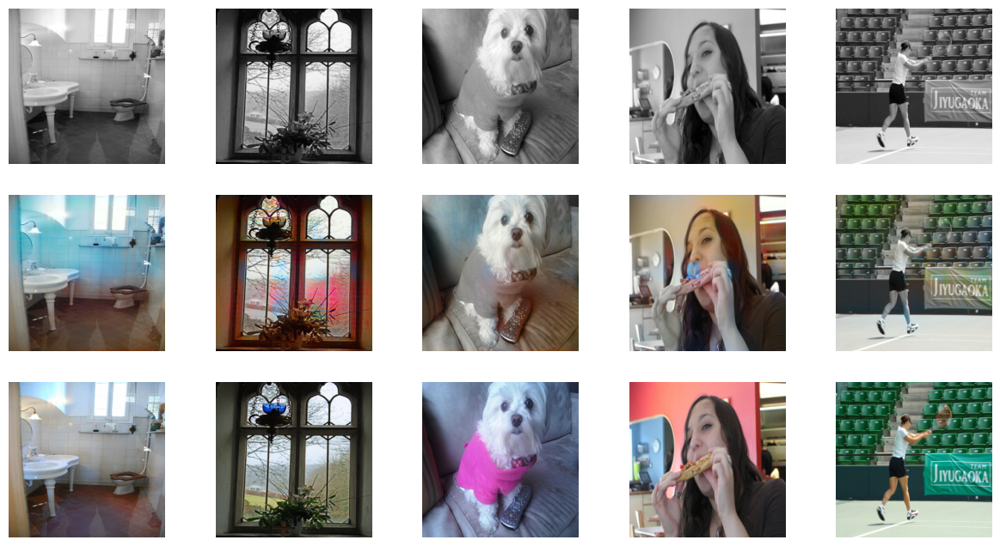


Epoch 3/10
Iteration 800/1125
loss_D_fake: 0.52177
loss_D_real: 0.58197
loss_D: 0.55187
loss_G_GAN: 1.24300
loss_G_L1: 10.99392
loss_G: 12.23692


<ipython-input-16-a66e46705176>:43: UserWarning: Conversion from CIE-LAB, via XYZ to sRGB color space resulted in 89 negative Z values that have been clipped to zero
  img_rgb = lab2rgb(img)
<ipython-input-16-a66e46705176>:43: UserWarning: Conversion from CIE-LAB, via XYZ to sRGB color space resulted in 79 negative Z values that have been clipped to zero
  img_rgb = lab2rgb(img)
<ipython-input-16-a66e46705176>:43: UserWarning: Conversion from CIE-LAB, via XYZ to sRGB color space resulted in 97 negative Z values that have been clipped to zero
  img_rgb = lab2rgb(img)
<ipython-input-16-a66e46705176>:43: UserWarning: Conversion from CIE-LAB, via XYZ to sRGB color space resulted in 29 negative Z values that have been clipped to zero
  img_rgb = lab2rgb(img)
<ipython-input-16-a66e46705176>:43: UserWarning: Conversion from CIE-LAB, via XYZ to sRGB color space resulted in 14 negative Z values that have been clipped to zero
  img_rgb = lab2rgb(img)
<ipython-input-16-a66e46705176>:43: UserWarni

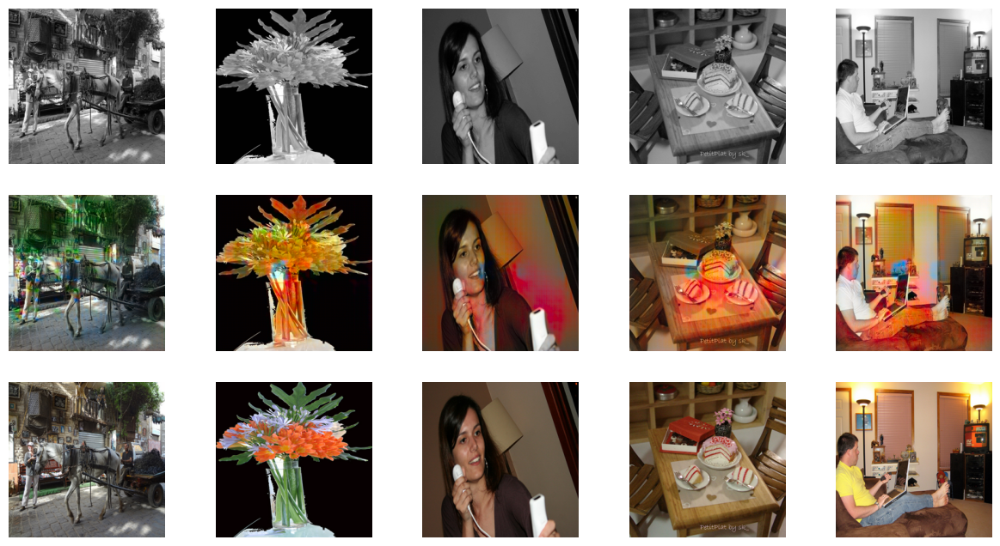


Epoch 3/10
Iteration 1000/1125
loss_D_fake: 0.52216
loss_D_real: 0.58030
loss_D: 0.55123
loss_G_GAN: 1.24027
loss_G_L1: 10.98489
loss_G: 12.22516


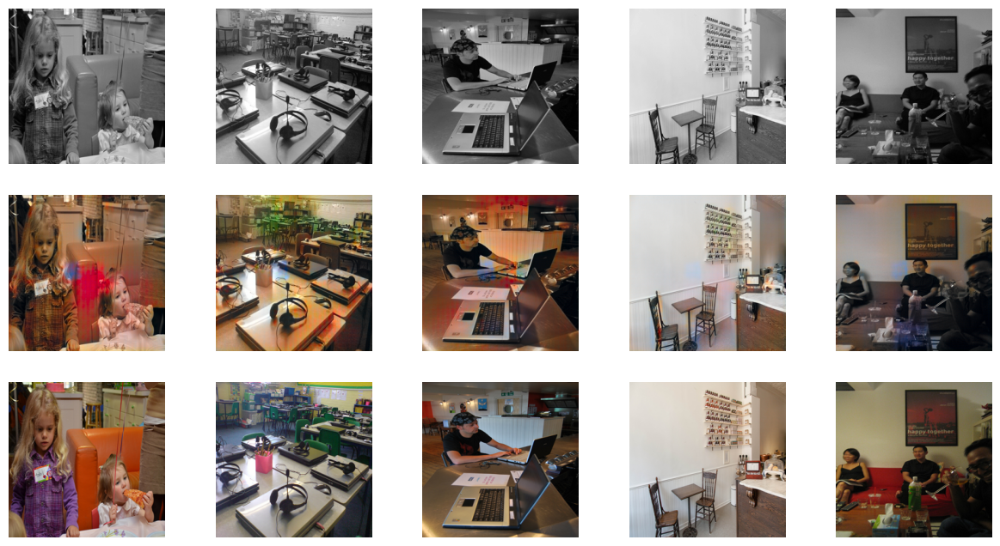

  0%|          | 0/1125 [00:00<?, ?it/s]


Epoch 4/10
Iteration 200/1125
loss_D_fake: 0.53672
loss_D_real: 0.58386
loss_D: 0.56029
loss_G_GAN: 1.24291
loss_G_L1: 10.92692
loss_G: 12.16983


<ipython-input-16-a66e46705176>:43: UserWarning: Conversion from CIE-LAB, via XYZ to sRGB color space resulted in 13 negative Z values that have been clipped to zero
  img_rgb = lab2rgb(img)
<ipython-input-16-a66e46705176>:43: UserWarning: Conversion from CIE-LAB, via XYZ to sRGB color space resulted in 31 negative Z values that have been clipped to zero
  img_rgb = lab2rgb(img)


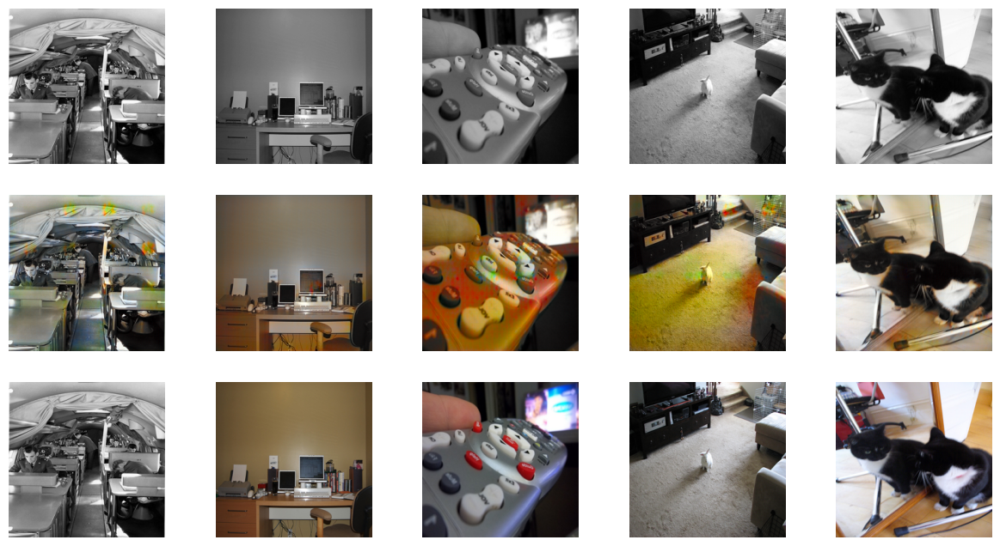


Epoch 4/10
Iteration 400/1125
loss_D_fake: 0.52338
loss_D_real: 0.57684
loss_D: 0.55011
loss_G_GAN: 1.26038
loss_G_L1: 10.92344
loss_G: 12.18382


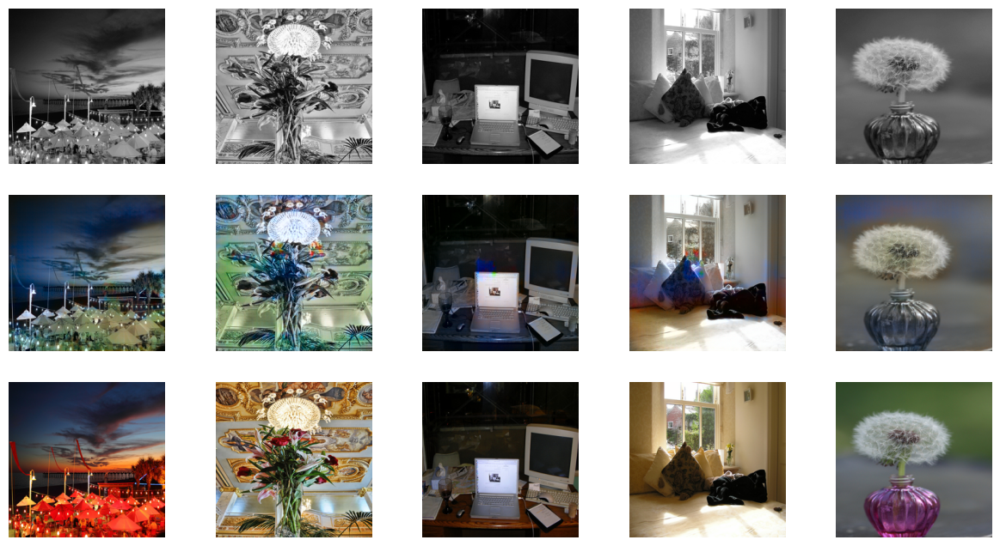


Epoch 4/10
Iteration 600/1125
loss_D_fake: 0.52013
loss_D_real: 0.57842
loss_D: 0.54928
loss_G_GAN: 1.26085
loss_G_L1: 10.95405
loss_G: 12.21490


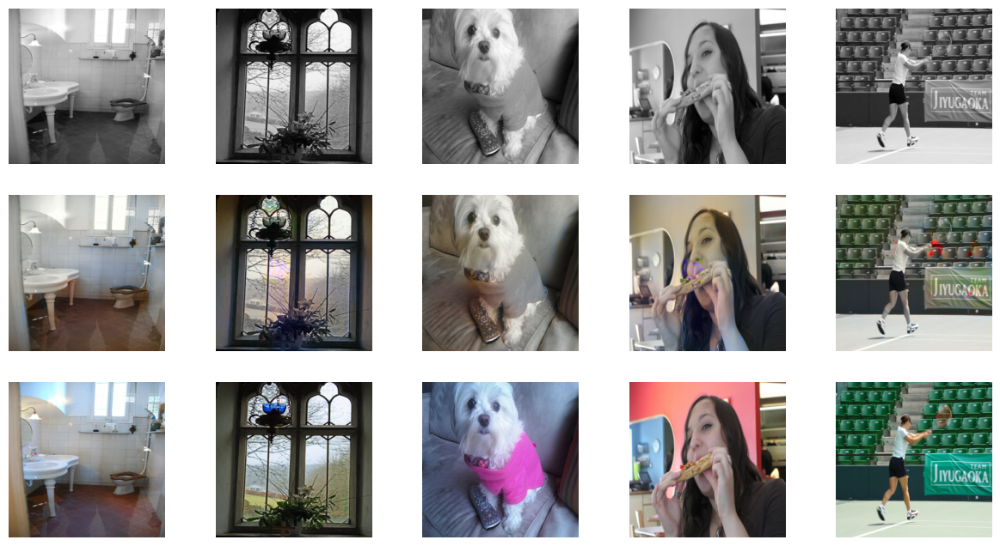


Epoch 4/10
Iteration 800/1125
loss_D_fake: 0.52286
loss_D_real: 0.57992
loss_D: 0.55139
loss_G_GAN: 1.24706
loss_G_L1: 10.91816
loss_G: 12.16522


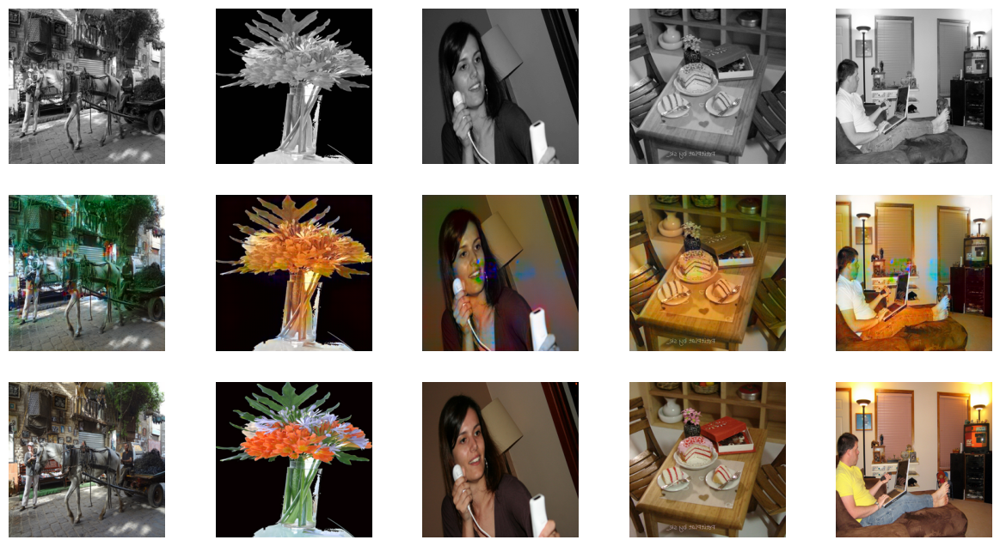


Epoch 4/10
Iteration 1000/1125
loss_D_fake: 0.52496
loss_D_real: 0.58040
loss_D: 0.55268
loss_G_GAN: 1.24339
loss_G_L1: 10.90483
loss_G: 12.14822


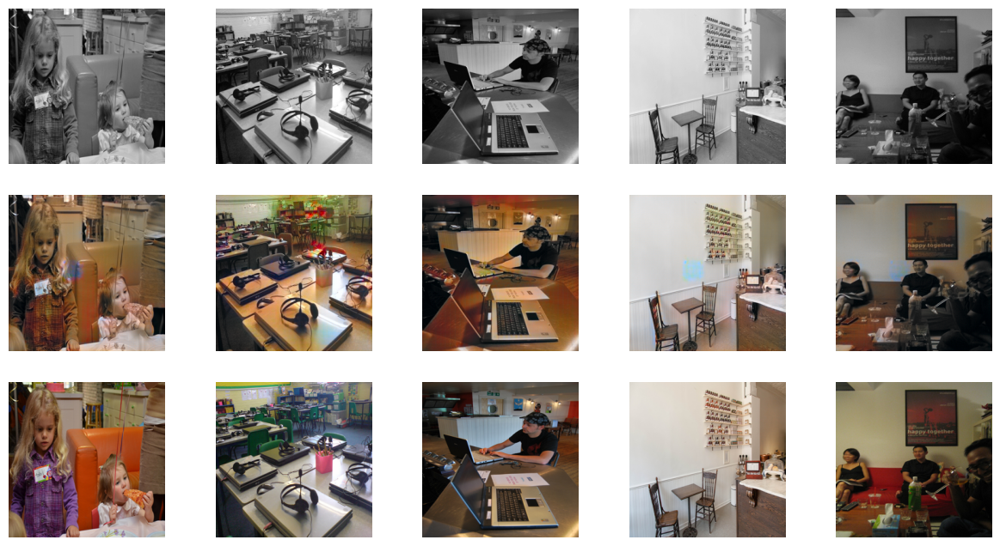

  0%|          | 0/1125 [00:00<?, ?it/s]

In [ ]:
def train_model(model, train_dl, epochs, display_every=200):
    data = next(iter(val_dl)) # getting a batch for visualizing the model output after fixed intrvals
    for e in range(epochs):
        loss_meter_dict = create_loss_meters() # function returing a dictionary of objects to
        i = 0                                  # log the losses of the complete network
        for data in tqdm(train_dl):
            model.setup_input(data)
            model.optimize()
            update_losses(model, loss_meter_dict, count=data['L'].size(0)) # function updating the log objects
            i += 1
            if i % display_every == 0:
                print(f"\nEpoch {e+1}/{epochs}")
                print(f"Iteration {i}/{len(train_dl)}")
                log_results(loss_meter_dict) # function to print out the losses
                visualize(model, data, save=False) # function displaying the model's outputs

model = MainModel()
train_model(model, train_dl, 10)

In [ ]:
log_every = 50  # Reduce for more frequent outputs
i = 0
for data in tqdm(val_dl):
    # Set up model input for colorization
    model.setup_input(data)

    # Forward pass to obtain colorized output
    model.forward()  # or the appropriate method to generate outputs

    # Visualize every log_every steps
    i += 1
    if i % log_every == 0:
        visualize(model, data, save=False)  # Confirm that visualize() is defined to display images

NameError: name 'tqdm' is not defined

In [ ]:
from fastai.vision.learner import create_body
from torchvision.models.resnet import resnet18
from fastai.vision.models.unet import DynamicUnet

In [ ]:
# Define the build_res_unet function
def build_res_unet(n_input=1, n_output=2, size=256):
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    # Instantiate the resnet18 model here
    body = create_body(resnet18(pretrained=True), n_in=n_input, cut=-2)
    net_G = DynamicUnet(body, n_output, (size, size)).to(device)
    return net_G

In [ ]:
 !gdown --id 1lR6DcS4m5InSbZ5y59zkH2mHt_4RQ2KV

In [ ]:
 net_G = build_res_unet(n_input=1, n_output=2, size=256)
 net_G.load_state_dict(torch.load("res18-unet.pt", map_location=device))
 model = MainModel(net_G=net_G)
 model.load_state_dict(torch.load("final_model_weights.pt", map_location=device))

In [ ]:

# Load and prepare the model
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# Load generator (Unet) weights
net_G = build_res_unet(n_input=1, n_output=2, size=256)
net_G.load_state_dict(torch.load("res18-unet.pt", map_location=device))

# Initialize MainModel and load its trained weights
model = MainModel(net_G=net_G).to(device)
model.load_state_dict(torch.load("final_model_weights.pt", map_location=device))

# Define the test function
def test_model(model, testloader):
    model.eval()  # Set model to evaluation mode
    test_losses = []  # Store test losses if desired

    with torch.no_grad():  # No gradients needed for testing
        for data in tqdm(testloader):
            model.setup_input(data)  # Prepare input for the model
            model.forward()  # Forward pass to get predictions

            # If model has a compute_loss method, use it to track test loss
            if hasattr(model, 'compute_loss'):
                test_loss = model.compute_loss()
                test_losses.append(test_loss.item())  # Store each test loss

            # Optionally visualize the model's output on test data
            visualize(model, data, save=False)

    # Calculate and print the average test loss if needed
    avg_test_loss = sum(test_losses) / len(test_losses) if test_losses else None
    if avg_test_loss is not None:
        print(f"\nAverage Test Loss: {avg_test_loss:.5f}")
    return avg_test_loss, test_losses


# Run the test function on test data
avg_test_loss, test_losses = test_model(model, val_dl)
